In [9]:
import torch
device = 'cuda' if torch.cuda.is_available else 'cpu'

## model load 

In [1]:
num_classes = 2
from models import get_instance_segmentation_model
model = get_instance_segmentation_model(num_classes)

import torch
model_path = './models/mrcnn_cp_v4_400.pth'
model_dict = torch.load(model_path)
model.load_state_dict(model_dict['state_dict'])

<All keys matched successfully>

## data load 

In [72]:
import albumentations as A
from albumentations.pytorch import ToTensorV2
valtf = A.Compose([
                  A.Normalize(),
                  ToTensorV2()
                  ], bbox_params=A.BboxParams(format='coco')
                    )
tf = A.Compose([
                  ToTensorV2()
                  ], bbox_params=A.BboxParams(format='coco')
                    )
from dataset import BCAD_CP_dt
bcad_img = './data/transformed_images'
bcad_ann = './data/annotations/v3v4_1.json'

dataset = BCAD_CP_dt(root=bcad_img,annFile=bcad_ann, mode='train', transforms=valtf)
dataset_display = BCAD_CP_dt(root=bcad_img,annFile=bcad_ann, mode='train', transforms=tf)


loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!


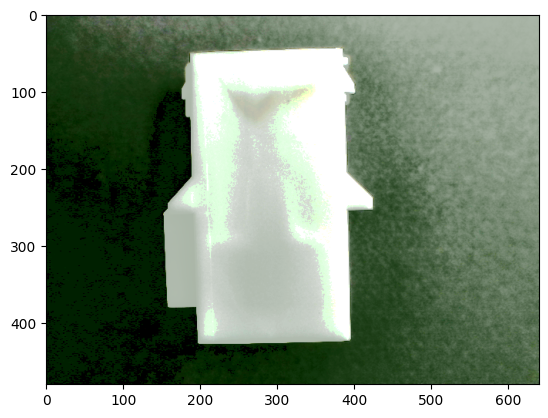

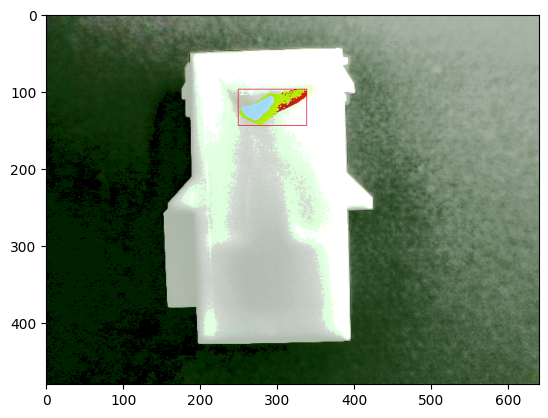

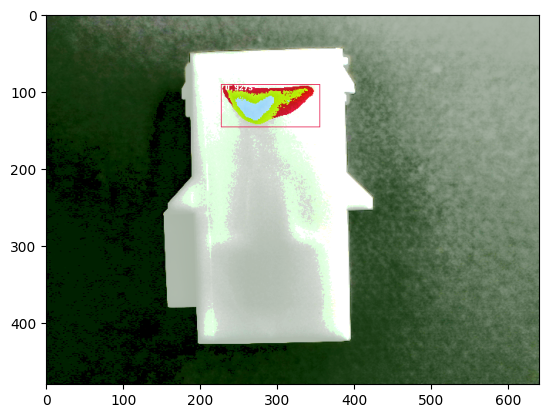

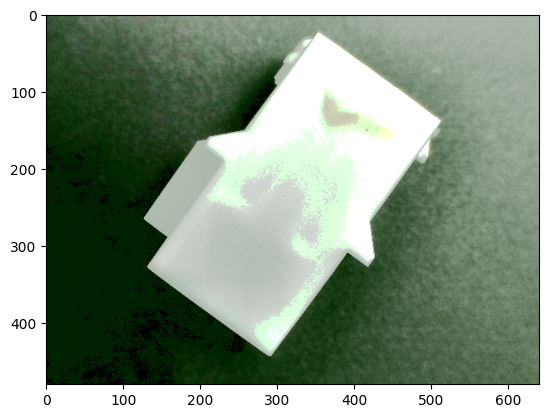

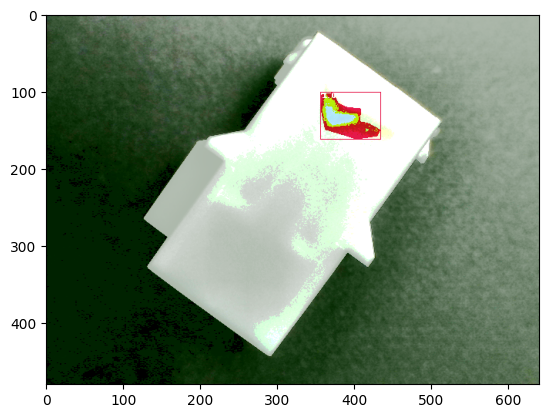

...

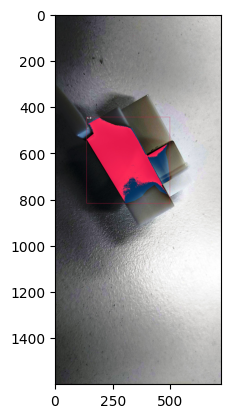

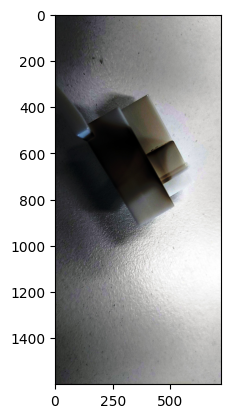

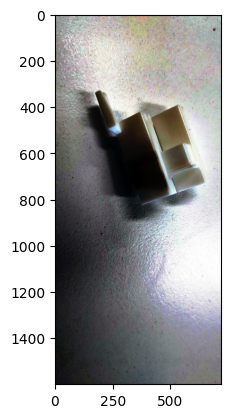

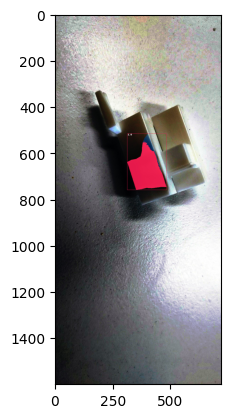

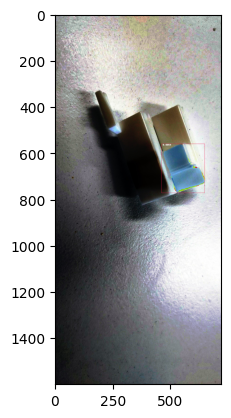

In [117]:
import  matplotlib.pyplot as plt


for idx in range(len(dataset)):
    x,y = dataset[idx]

    imgt = x.to(device) 
    model.to(device)

    import torchvision.transforms as T
    img = T.ToPILImage()(dataset_display[idx][0]).convert('RGB')


    model.eval()
    pre     = model([imgt])


    # draw prediction annotation (Mask ,Bbox ,score)

    N = len(y['boxes'])
    ann_scores = torch.tensor([1.0]*N)
    annimg = draw_ann(img,ann_scores,y['boxes'],y['masks'],nms=False)
    preimg = draw_ann(img,pre[0]['scores'].cpu(),pre[0]['boxes'].cpu(),pre[0]['masks'].cpu(),nms=True,conf_threshold=0.8)

    plt.imshow(img)
    plt.show()
    plt.imshow(annimg)
    plt.show()
    plt.imshow(preimg)
    plt.show()
    print('='*10)

In [13]:
import argparse
import importlib
import torch
import utils

import os
import sys

import torchvision
from PIL import Image, ImageDraw, ImageFont
import numpy as np

def draw_ann(img,scores,boxes,masks=None,nms=True,iou_threshold=0.5,conf_threshold=0.4 ,mask_threshold=0.5): # pil , tensor,tensor,float

    dis_rgbs = [(230, 25, 75), (60, 180, 75), (255, 225, 25), (0, 130, 200), (245, 130, 48), (145, 30, 180), (70, 240, 240), (240, 50, 230), (210, 245, 60), (250, 190, 212), (0, 128, 128),
        (220, 190, 255), (170, 110, 40), (255, 250, 200), (128, 0, 0), (170, 255, 195), (128, 128, 0), (255, 215, 180), (0, 0, 128), (128, 128, 128), (255, 255, 255), (0, 0, 0)]
    msk  = masks is not None
    size = img.size[::-1]

    # nms
    if nms :
        idx = torchvision.ops.nms(boxes,scores,iou_threshold=0.3)
        boxes  = boxes[idx]
        scores = scores[idx]
        if msk :
            masks = masks[idx]
    if conf_threshold :
        condition = scores>conf_threshold
        boxes  = boxes[condition]
        scores = scores[condition]   
        if msk :
            masks = masks[condition]
    if msk :
        if  'cuda' in masks.device.type:
            masks = masks.clone().detach().cpu()
        summask = np.zeros(size+(3,),dtype='uint8')
        for i,mask in enumerate(masks): 
            condi      = np.array(mask>0.5)
            condi_3    = np.concatenate([condi.reshape(size+(1,) )]*3,axis=2)
            colorMask  = np.array(Image.new('RGB',(size[1],size[0]),dis_rgbs[i]) )
            colorMask  = colorMask * condi_3 

            # multiply 1/2 if overlapped        
#             overlapped = (colorMask.sum(0) * summask.sum(0)).astype('bool')
#             overlapped = np.stack([overlapped,overlapped,overlapped]).reshape( num_condi.shape+(3,))
#             overMask   = colorMask*overlapped//2 + summask*overlapped//2
#             summask    = summask*(~overlapped) + colorMask*(~overlapped)
#             summask    = summask + overMask
            summask    = summask + (colorMask)
        # summask brightness
#         overlapped = 
#         imgnp , summask = np.array(img)[overlapped]//2 + summask[overlapped]//2
        imgnp           = np.array(img)
        img = Image.fromarray(imgnp+summask ) 
    
    annimg = img.copy()
    draw = ImageDraw.Draw(annimg)
    font = ImageFont.load_default()
    
    for i,box in enumerate(boxes):
        # draw.rectangle(xy=[0,0,150,150],outline=dis_rgb[2] )#, outline=label_color_map[det_labels[i]])
        box_xy = box.tolist()
        draw.rectangle(xy=box_xy,outline=dis_rgbs[i%len(dis_rgbs)] )#, outline=label_color_map[det_labels[i]])
        title = str(round(scores[i].item(),4))
        draw.text(xy=[box_xy[0]+len(title),box_xy[1]-1],text=title,fill='white',font=font)
    del draw
        
    
    return annimg

## torchvision based method  

In [123]:
import torch
import numpy as np
import matplotlib.pyplot as plt

import torchvision.transforms.functional as F

def show(imgs): # 0-255  
    if not isinstance(imgs, list):
        imgs = [imgs]
    fig, axs = plt.subplots(ncols=len(imgs), squeeze=False)
    for i, img in enumerate(imgs):
        img = img.detach()
        img = F.to_pil_image(img)
        axs[0, i].imshow(np.asarray(img))
        axs[0, i].set(xticklabels=[], yticklabels=[], xticks=[], yticks=[])

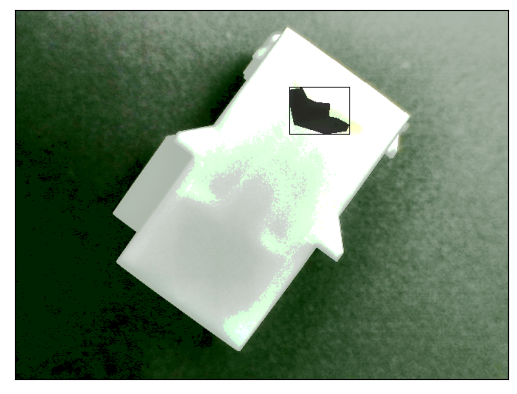

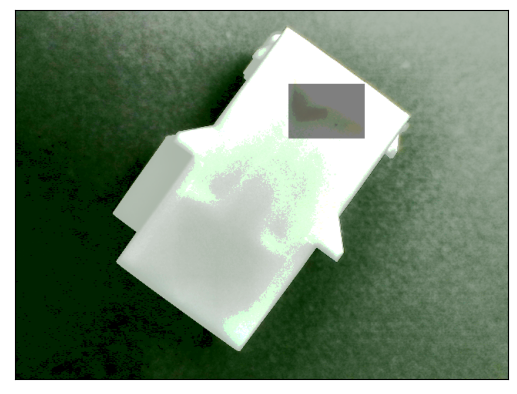

In [216]:
idx =1

img = dataset_display[idx][0] # 0-255
img_seg = torchvision.utils.draw_segmentation_masks(img,masks=dataset_display[idx][1]['masks'].to(torch.bool))
img_seg_bbox = torchvision.utils.draw_bounding_boxes(img_seg,boxes=dataset_display[idx][1]['boxes'])

show(img_seg_bbox)


x,y = dataset[idx]
imgt = x.to(device) 
model.to(device)
model.eval()
pre     = model([imgt])



confidence = 0.8
filtered = pre[0]['scores']>confidence
masks = masks=pre[0]['masks'][filtered].squeeze().to(torch.bool)
boxes = pre[0]['boxes'][filtered]
img_seg = torchvision.utils.draw_segmentation_masks(img,masks=masks,alpha=0.5)
# img_seg_bbox = torchvision.utils.draw_bounding_boxes(img_seg,boxes=boxes)

show(img_seg)

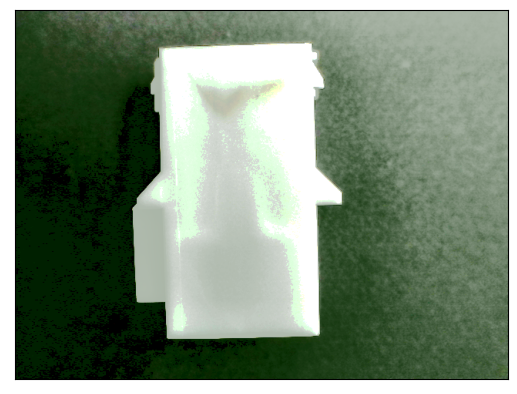

In [178]:
show(img)